[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/HumbertoDiego/AlgebraLinear-SFMTools/blob/main/fototri_mmi.ipynb)

# Fototriangulação pelo método dos modelos independentes

Geração de dois ou mais modelos fotogramétricos separadamente, cada um com seu próprio sistema de coordenadas, e depois alinhados (ajustados) entre si para formar uma rede contínua de pontos.

![image.png](data/image.png)

## Sumário

$\rightarrow$ 1. Visão geral do método

☐ 2. Coleta de pontos de controle no terreno (GCP)

☐ 3. Coleta de imagens aéreas

☐ 4. Coleta de pontos fotogramétricos

☐ 5. Orientação exterior

☐ 6. Orientação relativa: Ajustamento entre pares de fotos para recriar a geometria do voo (inclinação, rotação, diferença de altura, etc.) resultando no estereomodelo.

☐ 7. Ligação dos modelos: Depois que vários modelos independentes são criados, eles são ajustados entre si usando pontos em comum (pontos de amarração)


### (i) Relembrando ângulos de atitude

| Ângulos de atitude     | Parâmetros |
| ------------- | ------------- | 
| <img src="data/Rotação.jpeg"> | • $R_{y}= \begin{bmatrix} cos(\phi) &0 & -sen(\phi)\\0&1&0\\sen(\phi)&0&cos(\phi) \end{bmatrix}$ <br>• $R_{x}= \begin{bmatrix} 1 &0 & 0\\0&cos(\omega)&sen(\omega)\\0&-sen(\omega)&cos(\omega) \end{bmatrix}$ <br>• $R_{z}= \begin{bmatrix} cos(\kappa) &sen(\kappa) & 0\\-sen(\kappa)&cos(\kappa)&0\\0&0&1 \end{bmatrix}$| 

#### Implmentação da rotação geral (Rpry)

In [ ]:
import numpy as np

# Clockwise rotation matrixes for right hand axis
def Ry(pitch):
  return np.array([[np.cos(pitch), 0, -np.sin(pitch)],
                   [0            , 1,      0        ],
                   [np.sin(pitch), 0, np.cos(pitch) ]])
def Rx(roll):
  return np.array([[1,        0      ,      0     ],
                   [0, np.cos(roll) , np.sin(roll)],
                   [0, -np.sin(roll), np.cos(roll)]])
def Rz(yaw):
  return np.array([[np.cos(yaw) ,np.sin(yaw), 0],
                   [-np.sin(yaw),np.cos(yaw), 0],
                   [0             ,0        , 1]])
def Rrpy(pitch, roll, yaw):
  # (pitch, roll, yaw)=(phi, omega, kappa) --> sim, talvez, não
  return Rx(np.deg2rad(roll)) @ Ry(np.deg2rad(pitch)) @  Rz( np.deg2rad(yaw))

# Teste se Rpry^T = Rpry^-1
pitch, roll, yaw = 10, 20, 30
R = Rrpy(pitch, roll, yaw)
print(R)
print(R.T)
print(np.linalg.inv(R))
print(np.allclose(R.T, np.linalg.inv(R)))
print(np.allclose(R @ R.T, np.eye(3)))

[[ 0.85286853  0.49240388 -0.17364818]
 [-0.41841204  0.84349327  0.33682409]
 [ 0.31232456 -0.21461018  0.92541658]]
[[ 0.85286853 -0.41841204  0.31232456]
 [ 0.49240388  0.84349327 -0.21461018]
 [-0.17364818  0.33682409  0.92541658]]
[[ 0.85286853 -0.41841204  0.31232456]
 [ 0.49240388  0.84349327 -0.21461018]
 [-0.17364818  0.33682409  0.92541658]]
True
True


##### Teste da rotação

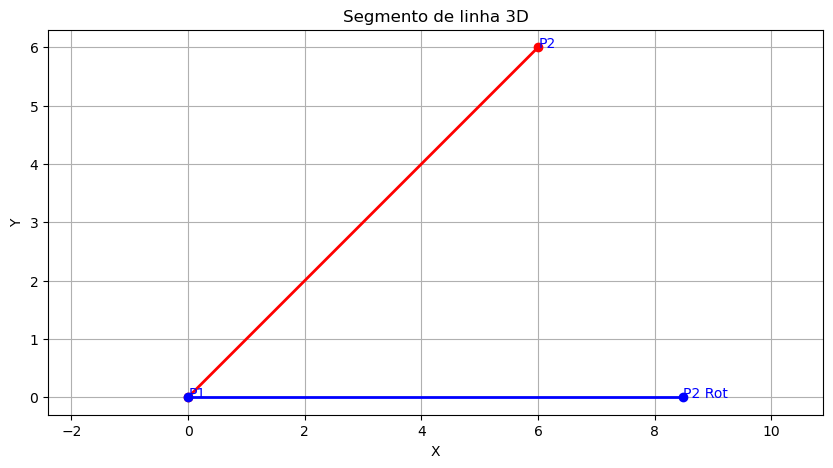

In [42]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D

# Pontos extremos do segmento de linha
p1 = np.array([0, 0, 0])
p2 = np.array([6, 6, 0])

# Coordenadas x, y, z do segmento
x = [p1[0], p2[0]]
y = [p1[1], p2[1]]
z = [p1[2], p2[2]]

# Criar figura 3D
fig, ax = plt.subplots(1, 1, figsize=(10, 5))

# Plotar segmento de linha
ax.plot(x, y, color='red', linewidth=2, marker='o')
ax.text(p1[0], p1[1], "P1", color='blue')
ax.text(p2[0], p2[1], "P2", color='blue')

# Configurar rótulos e visualização
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_title('Segmento de linha 3D')

# Aplicar rotação
pitch, roll, yaw = 0, 0, 45
p1_rot = Rrpy(pitch, roll, yaw) @ p1
p2_rot = Rrpy(pitch, roll, yaw) @ p2
# Coordenadas x, y, z do segmento rotacionado
x = [p1_rot[0], p2_rot[0]]
y = [p1_rot[1], p2_rot[1]]
z = [p1_rot[2], p2_rot[2]]

ax.plot(x, y, color='blue', linewidth=2, marker='o')
ax.text(p2_rot[0], p2_rot[1], "P2 Rot", color='blue')

plt.axis('equal')
plt.grid()
plt.show()

### (ii) Relembrando modelo da câmera de orifício

| Modelo da câmera de orifício     | Parâmetros |
| ------------- | ------------- | 
| <img src="data/pinhole_camera_model.png" style="background-color: white;"> | Sistemas de referência:<br>• $[X_w \ Y_w\  Z_w]$ são as coordenadas do ponto de interesse no sistema de referência do espaço-objeto;<br>• $[X_c\  Y_c\ Z_c]$ são as  coordenadas do ponto de interesse no sistema de referência da câmera;<br>• $[x \ y]$ são as coordenadas do ponto de interesse no plano da imagem em [mm];<br>• $[u\ v]$ são as coordenadas coluna e linha do ponto de interesse no plano da imagem em [pixels]. <br><br> Dados:<br>  • $f$ é a distância focal;<br>  • $[X_w^O \ Y_w^O\  Z_w^O]=O=CP$ é o Centro de projeção, também chamado de Centro de perspectiva; <br>  • $[X_w^P \ Y_w^P\  Z_w^P]=P$ é o ponto-objeto;<br>  • $[X_w^p \ Y_w^p\  Z_w^p]=p$ é o ponto-imagem;<br>• $[c_x \ c_y \ f]$ é o ponto principal, ou seja, a projeção de $O$ no sistema-imagem | 



### (iii) Relembrando modelo da câmera aerofotogramétrica

| Modelo da câmera aerofotogramétrica <br>$(\phi,\omega,\kappa) = (0,0,0)$| <img src="data/modelo_camera_aerofotogramétrica0.jpg" > |• $P = (X'_P \ Y'_P \ Z'_P)$ <br> • $p = (x_p \ y_p \ f)$ <br> • $PP = (x_0 \ y_0 \ f)$ <br> • $O = (X'_0 \ Y'_0 \ Z'_0)$<br>• Condição de colinearidade: <br> no momento da tomada da fotografia,<br> o ponto-objeto $P$, o centro de projeção <br> $O$ e o ponto-imagem $p$ formam uma <br> linha reta. |
| ------------- | ------------- | ------------ |
| Correção pelos ângulos de atitude <br>$(\phi,\omega,\kappa) \ne (0,0,0)$| <img src="data/modelo_camera_aerofotogramétrica.jpg" > |      |

| Modelo da câmera fotogramétrica     | Parâmetros |
| ------------- | ------------- | 
| <img src="data/photogrametric_camera_model.png" style="background-color: white;"> | $\overrightarrow{X}_{A} = \overrightarrow{X}_{IMU} + R_{pry}\overrightarrow{X}_0 + R_{pry} R_b R_v \overrightarrow{X}_L$ | 

## Sumário

☑ 1. Visão geral do método

$\rightarrow$ 2. Coleta de pontos de controle no terreno (GCP)

☐ 3. Coleta de imagens aéreas

☐ 4. Coleta de pontos fotogramétricos

☐ 5. Orientação exterior

☐ 6. Orientação relativa: Ajustamento entre pares de fotos para recriar a geometria do voo (inclinação, rotação, diferença de altura, etc.) resultando no estereomodelo.

☐ 7. Ligação dos modelos: Depois que vários modelos independentes são criados, eles são ajustados entre si usando pontos em comum (pontos de amarração)


| Abertura de clareira      | Medição da coordenada      | Plotagem |
| ------------- | ------------- | --------|
| ![image2.png](data/image2.png) | ![image3.png](data/image3.png) | ![image4.png](data/image4.png) |

In [25]:
import requests 
import os

filename = 'coleta de pontos.mp4'
video_path = os.path.join("data", filename)

if not os.path.exists(video_path):
    url = "https://drive.usercontent.google.com/download?id=1awR3k-sXaKCcYMwS3dcU6bVTQLZYaFHQ&export=download&authuser=0"
    r = requests.get(url)

    if r.status_code == 200:
        if not os.path.exists("data"):
            os.mkdir("data")
        video_path = os.path.join("data", filename)
        if not os.path.exists(video_path):
            # Open a file in write-binary mode
            with open(video_path, 'wb') as file:
                # Write the content of the response to the file
                file.write(r.content)
            print("File downloaded and saved successfully.")
    else:
        print(f"Failed to download file. Status code: {r.status_code}")

# Play movie
from IPython.display import HTML
from base64 import b64encode
mp4 = open(video_path,'rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()
HTML("""
<video controls  height="600" >
      <source src="%s" type="video/mp4">
</video>
""" % data_url)

### Pontos de controle 2º Gpt Eng - Manaus/AM:

  field_1            N           E       Z                        geometry
0    None  9657936.654  825134.948  64.640  POINT (825134.948 9657936.654)
1    None  9657987.969  825044.809  63.901  POINT (825044.809 9657987.969)
2    None  9658057.490  825077.199  62.756   POINT (825077.199 9658057.49)
3    None  9658013.652  825154.511  63.358  POINT (825154.511 9658013.652)
EPSG:31980


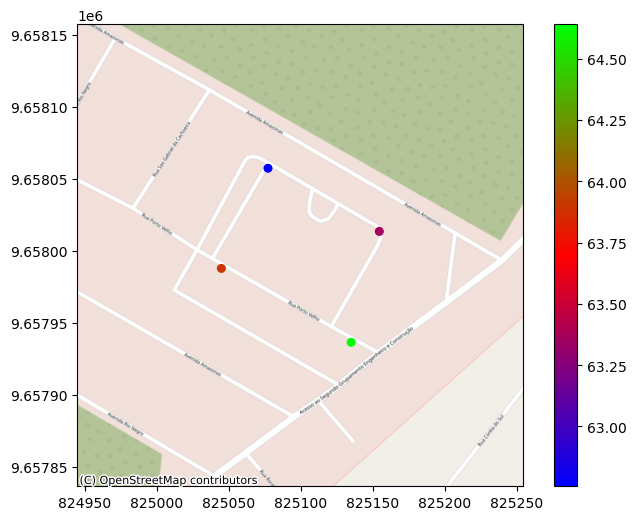

In [ ]:
try:
    import geopandas as gpd
except ImportError:
    !pip install geopandas
    import geopandas as gpd

try:
    import contextily as cx
except ImportError:
    !pip install contextily
    import contextily as cx

import matplotlib.pyplot as plt

# Load the shapefile
gdf = gpd.read_file("data/pts_controle_gec.shp")

# Display the first few rows to see the points and EPSG
print(gdf.head())
print(gdf.crs)

# Plot the points
f, ax = plt.subplots(figsize=(8, 6))
gdf.plot(column="Z", legend=True, ax=ax, cmap="brg", markersize=30)

# Extend the limits
ax.set_ylim(gdf["N"].min() - 100, gdf["N"].max() + 100 )
ax.set_xlim(gdf["E"].min() - 100, gdf["E"].max() + 100 )

# Add basemap
# https://contextily.readthedocs.io/en/latest/intro_guide.html
cx.add_basemap(ax, 
               crs=gdf.crs.to_string(), 
               zoom =19,
               source=cx.providers.OpenStreetMap.Mapnik) 

plt.show()

## Sumário

☑ 1. Coleta de pontos de controle no terreno (GCP)

$\rightarrow$ 2. Coleta de imagens aéreas

☐ 3. Coleta de pontos fotogramétricos

☐ 4. Orientação exterior

☐ 5. Orientação relativa: Ajustamento entre pares de fotos para recriar a geometria do voo (inclinação, rotação, diferença de altura, etc.) resultando no estereomodelo.

☐ 6. Ligação dos modelos: Depois que vários modelos independentes são criados, eles são ajustados entre si usando pontos em comum (pontos de amarração)


| DJI_0018.JPG      | DJI_0019.JPG      | DJI_0020.JPG |
| ------------- | ------------- | --------|
| ![DJI_0018.JPG](data/FOTOS_VOO_2GPTE/DJI_0018.JPG) | ![image19.png](data/FOTOS_VOO_2GPTE/DJI_0019.JPG) | ![image20.png](data/FOTOS_VOO_2GPTE/DJI_0020.JPG) |

## Sumário

☑ 1. Coleta de pontos de controle no terreno (GCP)

☑  2. Coleta de imagens aéreas

$ \rightarrow $ 3. Coleta de pontos fotogramétricos

☐ 4. Orientação exterior

☐ 5. Orientação relativa: Ajustamento entre pares de fotos para recriar a geometria do voo (inclinação, rotação, diferença de altura, etc.) resultando no estereomodelo.

☐ 6. Ligação dos modelos: Depois que vários modelos independentes são criados, eles são ajustados entre si usando pontos em comum (pontos de amarração)


In [ ]:
!pip install ipyevents ipycanvas ipywidgets

In [35]:
import ipywidgets as widgets
from ipyevents import Event
from ipycanvas import Canvas
from IPython.display import display
from PIL import Image
import io
import numpy as np


# Criar uma imagem de exemplo
img = Image.open(f"data/FOTOS_VOO_2GPTE/DJI_00{18}.JPG")

# Converter imagem para bytes
buf = io.BytesIO()
img.save(buf, format='PNG')
buf.seek(0)
img_data = buf.read()

# Converter imagem para array numpy
# img = Image.open(io.BytesIO(img_data))
img_array = np.array(img)

# # Criar widget de imagem
# image_widget = widgets.Image(
#     value=img_data,
#     format='png',
#     width=1600,
#     height=900
# )

# Criar um Textarea para mostrar o clique
textarea = widgets.Textarea(
    value='Clique na imagem!',
    layout=widgets.Layout(width='1200px')
)

# Criar um Canvas
canvas = Canvas()

# Passar a imagem para o canvas
canvas.put_image_data(img_array, 0, 0)

# Criar um Event listener para o canvas
click_event = Event(source=canvas, watched_events=['click'])

# Função que será chamada ao clicar
def handle_click(event):
    x = event['relativeX']
    y = event['relativeY']
    textarea.value = f'Coluna (X): {x}\nLinha (Y): {y}\nRGB: {img_array[y, x]}\n'

    # Desenhar um X vermelho
    canvas.stroke_style = 'red'
    canvas.line_width = 2
    canvas.begin_path()
    canvas.move_to(x-5, y-5)
    canvas.line_to(x+5, y+5)
    canvas.move_to(x-5, y+5)
    canvas.line_to(x+5, y-5)
    canvas.stroke()

# Ligar evento ao handler
click_event.on_dom_event(handle_click)

# Mostrar tudo
display(widgets.VBox([canvas, textarea]))